In [13]:
%run ../../scAAnet/api.py
%run ../../scAAnet/train.py
%run ../../scAAnet/network.py
%run ../../scAAnet/tools.py
%run ../../scripts/functions.py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
from sklearn.metrics import silhouette_score
import scanpy as sc
import tensorflow as tf
import anndata as ad
np.random.seed(42)
tf.random.set_seed(42)
from collections import OrderedDict 
import matplotlib
from scipy.stats import f_oneway, ks_2samp
from itertools import combinations

# set up

In [8]:
figure_path = '../../figures/exp03/3_figures'
data_path = '../../data/only_healthy_data'
pathways = pd.read_csv(f'{data_path}/batchfix_paths_healthy_samples_pathway_counts.csv', sep=',', index_col=0, header=0)
metadata = pd.read_csv(f'{data_path}/batchfix_paths_healthy_samples_pathway_metadata.csv', sep=',', index_col=0, header=0)
metadata.rename(columns={'Global.Region': 'Global Region'}, inplace=True)

In [9]:
import pickle
with open('../../data/scAAnet_output/clean_100_rs.pkl', 'rb') as f:
    clean_100_states = pickle.load(f)

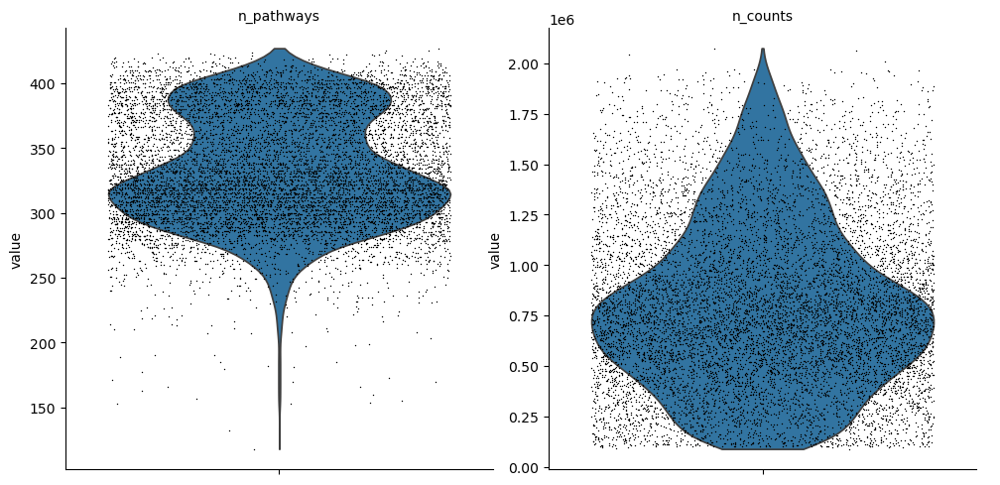

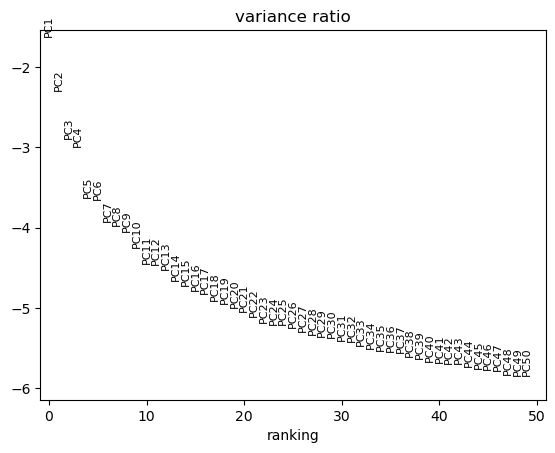

/data/lab_vm/campervans/mmeawad_test/anaconda/test4.2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


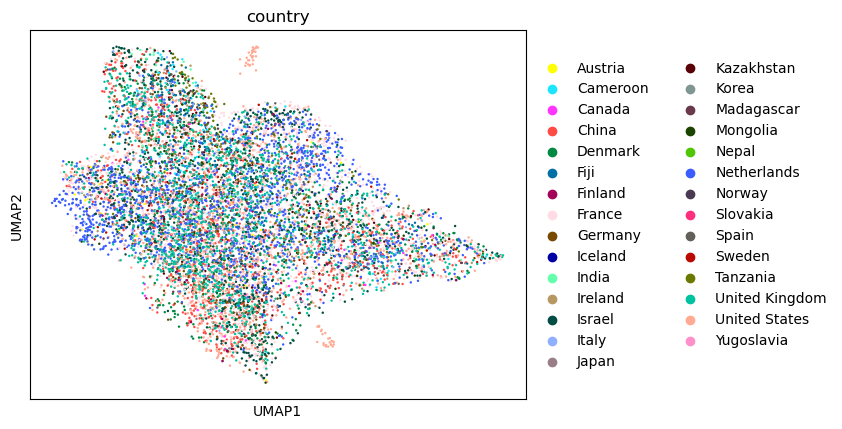

/data/lab_vm/campervans/mmeawad_test/anaconda/test4.2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


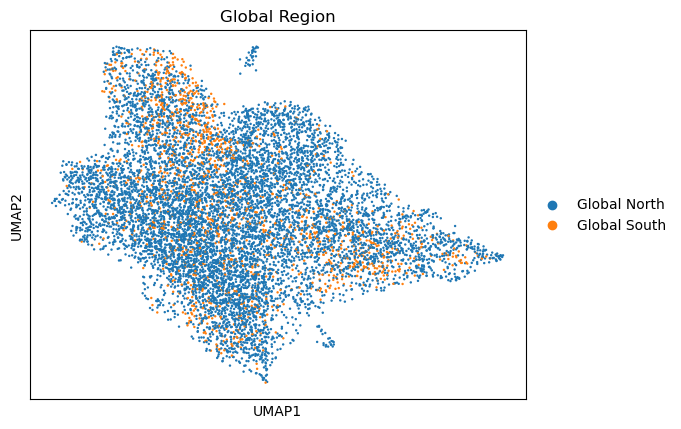

/data/lab_vm/campervans/mmeawad_test/anaconda/test4.2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


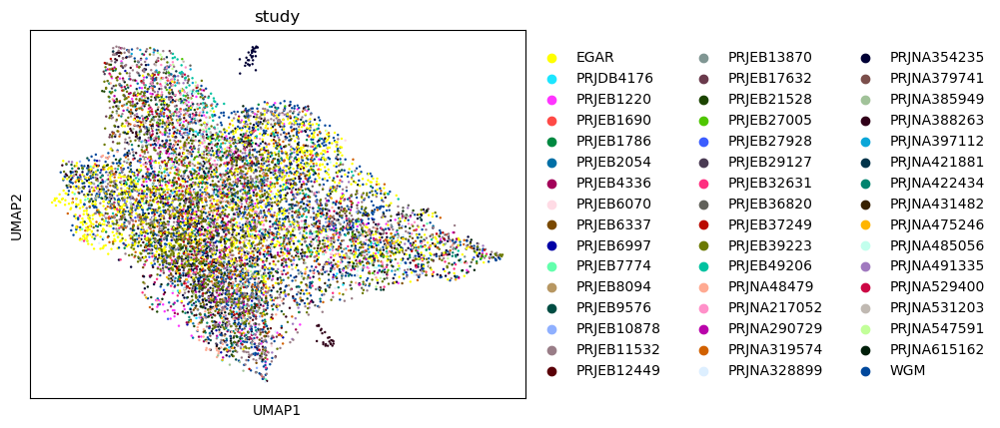

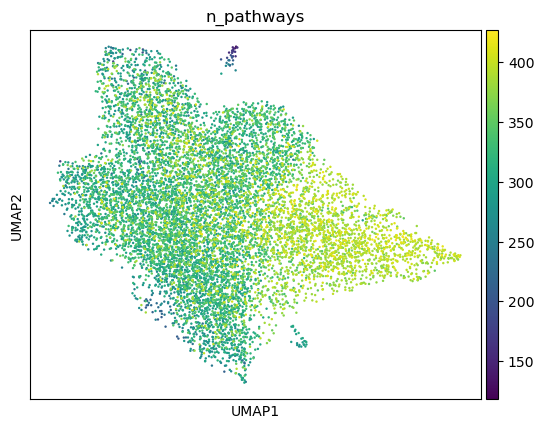

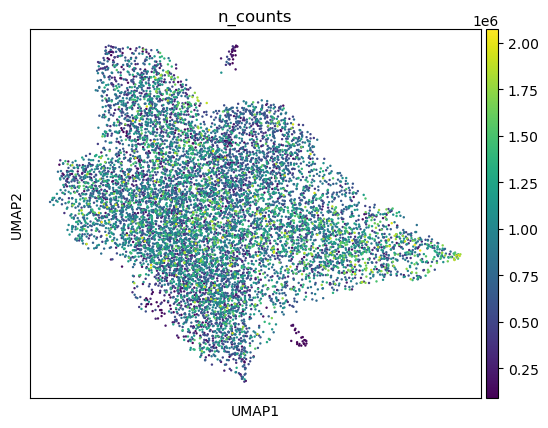

In [10]:
concat_ad = convertToAnnData(pathways, metadata)

In [11]:
# Calculate the average n_pathways across all cells
average_n_pathways = concat_ad.obs['n_pathways'].mean()
# Calculate the range of n_pathways (min to max)
min_n_pathways = concat_ad.obs['n_pathways'].min()
max_n_pathways = concat_ad.obs['n_pathways'].max()
# Display the results
print(f"Average n_pathways: {average_n_pathways}")
print(f"Range of n_pathways: {min_n_pathways} to {max_n_pathways}")

Average n_pathways: 333.1499288473267
Range of n_pathways: 118 to 427


# rs 53

In [12]:
dist = 'nb'
K = 3

counts = concat_ad

recon = clean_100_states[(3, 53)]['recon']
usage = clean_100_states[(3, 53)]['usage']
spectra = clean_100_states[(3, 53)]['spectra']
gene_score = clean_100_states[(3, 53)]['gene_score']
gene_score.index = pathways.index

usage = pd.DataFrame(usage, index=counts.obs.index, columns = np.arange(1,K+1))
usage.columns = ['type3', 'type1', 'type2']
desired_order = ['type1', 'type2', 'type3']
usage = usage[desired_order]

gene_score.columns = ['type3', 'type1', 'type2']
desired_order = ['type1', 'type2', 'type3']
gene_score = gene_score[desired_order]

spectra = pd.DataFrame(np.transpose(spectra), index=counts.var.index, columns=usage.columns)
recon = pd.DataFrame(recon, index=counts.obs.index, columns=counts.var.index)
usage = usage.apply(pd.to_numeric, errors='coerce').astype('float64')

usageandmeta = usage.merge(counts.obs, left_index=True, right_index=True)

In [24]:
from sklearn.manifold import MDS
data_at = usage.to_numpy()
embedding = MDS(n_components=2, random_state=42)
Y_mds_ats = embedding.fit_transform(np.transpose(spectra))
Y_mds_data = data_at @ Y_mds_ats
(fig, ax) = plt.subplots(1,3,figsize=(25, 8), dpi=600)
plt.suptitle('')
for i in range(1):
    for j in range(3):
        ax[j].set_xticks([])
        ax[j].set_yticks([])
        ax[j].set_xlabel('MDS1', fontsize=15)
        ax[j].set_ylabel('MDS2', fontsize=15)
        g = ax[j].scatter(Y_mds_data[:,0], Y_mds_data[:,1], s=1, alpha=0.5,
                   cmap='inferno', c=usage.iloc[:, i*5+j], vmin=0, vmax=1)
        ax[j].set_title('GEP %d' % (i*5+j+1), fontsize=12)
        ax[j].scatter(Y_mds_ats[:,0], Y_mds_ats[:,1], s=200, c='r', zorder=3)
        for k in range(Y_mds_ats.shape[0]):
            ax[j].text(Y_mds_ats[k,0], Y_mds_ats[k,1], k+1, horizontalalignment='center', verticalalignment='center', fontdict={'color': 'white','size':15,'weight':'bold'}, zorder=4)
    plt.colorbar(g, ax=ax[j])
plt.savefig(f'{figure_path}/figure2A_rs53_AAspace.pdf', format='pdf')
fig.tight_layout()

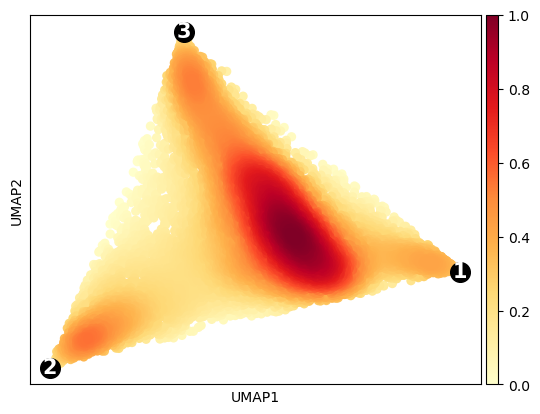

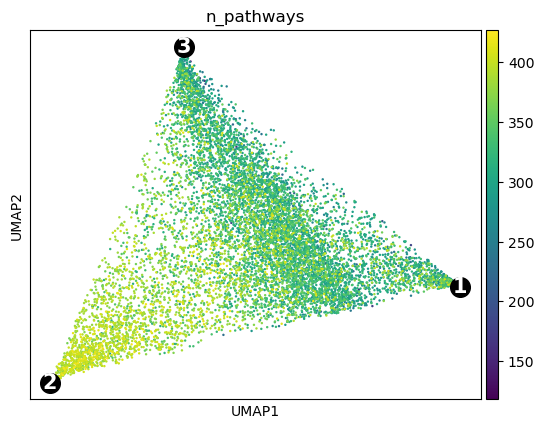

In [26]:
concat_ad.obsm['X_umap'] = Y_mds_data
sc.tl.embedding_density(concat_ad, basis='umap')
fig, ax = plt.subplots(1, 1)
for i in range(K):
    ax.scatter(Y_mds_ats[i, 0], Y_mds_ats[i, 1], s=200, c='k', zorder=3)
    ax.text(
        Y_mds_ats[i, 0], Y_mds_ats[i, 1], i + 1,
        horizontalalignment='center',
        verticalalignment='center',
        fontdict={'color': 'white', 'size': 15, 'weight': 'bold'},
        zorder=4
    )
sc.pl.embedding_density(concat_ad, basis='umap', ax=ax, save="figure2B_AAspace_density.pdf")

obs_list = ['n_pathways']
for j in obs_list:
    concat_ad.obsm['X_umap'] = Y_mds_data
    (fig, ax) = plt.subplots(1,1)
    for i in range(K):
        ax.scatter(Y_mds_ats[i,0], Y_mds_ats[i,1], s=200, c='k', zorder=3)
        ax.text(Y_mds_ats[i,0], Y_mds_ats[i,1], i+1, horizontalalignment='center', verticalalignment='center', 
                fontdict={'color':'white','size':15,'weight':'bold'}, zorder=4)
    sc.pl.umap(concat_ad, color=j, ax=ax, legend_fontsize=12, save = f"figure2C_AAspace_{j}.pdf")
        
import shutil
import os
temp = "./figures"
# Check if the source directory exists
if os.path.exists(temp):
    # Rename files to remove the "umap" prefix and move them to the destination directory
    for file_name in os.listdir(temp):
        full_file_name = os.path.join(temp, file_name)
        if os.path.isfile(full_file_name):  # Check if it's a file
            # Remove "umap" prefix if it exists
            new_file_name = file_name.replace("umap", "", 1)
            destination = os.path.join(figure_path, new_file_name)
            shutil.move(full_file_name, destination)
    
    # Remove the empty figures directory
    if not os.listdir(temp):  # Check if the directory is empty
        os.rmdir(temp)  # Remove the directory
else:
    print(f"The directory {temp} does not exist.")

Shape of top_20_df: (60, 3)


/tmp/ipykernel_4036981/1001850489.py:23: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


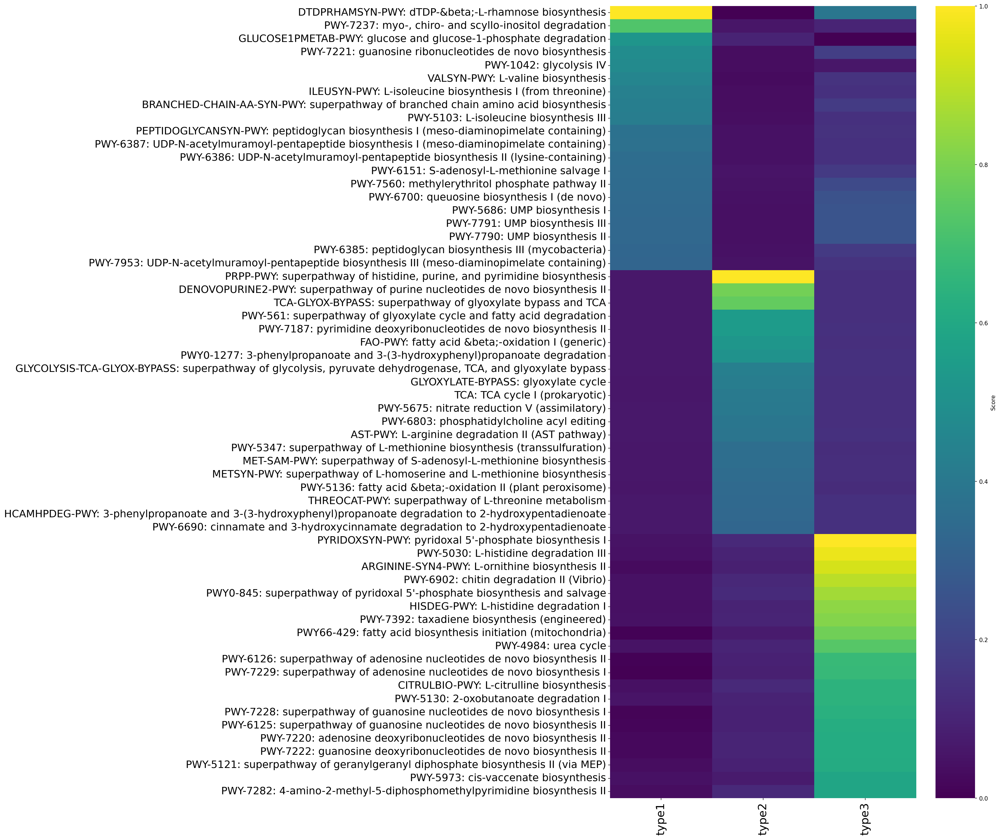

In [27]:
num_g = 20
# Step 1: Collect the top indices from each column
top_indices_per_column = []
for col in gene_score.columns:
    # Get the top 'num_g' indices for the current column
    top_indices = gene_score[col].nlargest(num_g).index.tolist()
    top_indices_per_column.extend(top_indices)

# Step 2: Remove duplicates while preserving order
top_indices_unique = list(OrderedDict.fromkeys(top_indices_per_column))

# Step 3: Reindex your DataFrame to have indices in the desired order
top_20_df = gene_score.loc[top_indices_unique]
print(f"Shape of top_20_df: {top_20_df.shape}")
top_20_df.to_csv(f'../../data/scAAnet_output/sorted_top20_state53_heatmapdata.csv')

plt.figure(figsize=(12, 25))
sns.heatmap(top_20_df, annot=False, cmap='viridis', fmt='g', cbar_kws={'label': 'Score'})
plt.yticks(rotation=0, fontsize=18, ha='right')  # Increase font size and align labels horizontally
plt.xticks(fontsize=20, rotation=90)

#plt.title(f'Heatmap of Top {num_g} Pathways in Each Archetype\nTotal of {top_20_df.shape[0]} Unique Pathways')
plt.tight_layout()
plt.gcf().set_dpi(150)  # Higher DPI for better resolution
plt.savefig(f'{figure_path}/figure2E_top20genes_heatmap.pdf', format='pdf', bbox_inches='tight')
plt.show()

# supplementary analysis and figures

In [14]:
# Define the grouping of countries into regions
country_to_region = {
    'Austria': 'Europe and Northern America',
    'Denmark': 'Europe and Northern America',
    'Spain': 'Europe and Northern America',
    'India': 'Central and Southern Asia',
    'China': 'Eastern and South-Eastern Asia',
    'United States': 'Europe and Northern America',
    'Canada': 'Europe and Northern America',
    'Netherlands': 'Europe and Northern America',
    'Japan': 'Eastern and South-Eastern Asia',
    'Ireland': 'Europe and Northern America',
    'Germany': 'Europe and Northern America',
    'Kazakhstan': 'Central and Southern Asia',
    'Tanzania': 'Sub-Saharan Africa',
    'Sweden': 'Europe and Northern America',
    'France': 'Europe and Northern America',
    'Iceland': 'Europe and Northern America',
    'Cameroon': 'Sub-Saharan Africa',
    'Korea': 'Eastern and South-Eastern Asia',
    'Norway': 'Europe and Northern America',
    'Yugoslavia': 'Europe and Northern America',
    'Slovakia': 'Europe and Northern America',
    'United Kingdom': 'Europe and Northern America',
    'Nepal': 'Central and Southern Asia',
    'Mongolia': 'Eastern and South-Eastern Asia',
    'Israel': 'Northern Africa and Western Asia',
    'Madagascar': 'Sub-Saharan Africa',
    'Finland': 'Europe and Northern America',
    'Fiji': 'Australia/New Zealand',
    'Italy': 'Europe and Northern America'
}

# Add the 'region' column based on the mapping
usageandmeta['region'] = usageandmeta['country'].map(country_to_region)

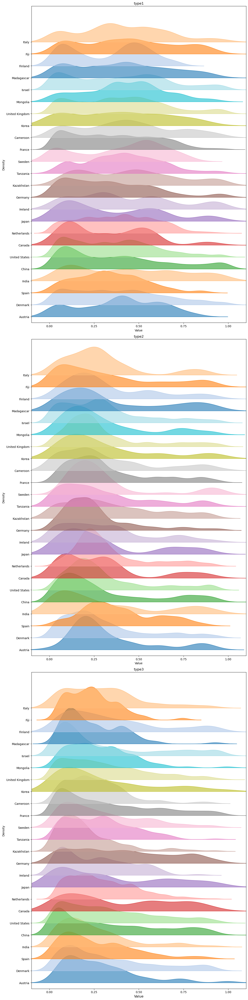

In [15]:
matplotlib.rcParams['pdf.fonttype'] = 42

# Example list of types
listt = ['type1', 'type2', 'type3']

# Filter countrys with at least 30 samples
filtered_df = usageandmeta.groupby('country').filter(lambda x: len(x) >= 30)
filtered_df = filtered_df.copy()
filtered_df['country'] = filtered_df['country'].astype(str)

# Define a consistent color palette for countrys
country_order = filtered_df['country'].unique()
palette = sns.color_palette("tab20", n_colors=len(country_order))
color_mapping = dict(zip(country_order, palette))  # Map each country to a specific color

# Set up the subplot grid
fig, axes = plt.subplots(len(listt), 1, figsize=(12, len(country_order) * 2), sharex=False)

# Loop through each type and create a subplot
vertical_spacing = 1.1  # Spacing between countrys
for ax, type_name in zip(axes, listt):
    melted_df = filtered_df[['country', type_name]].rename(columns={type_name: 'Value'})
    melted_df['country'] = pd.Categorical(melted_df['country'], categories=country_order, ordered=True)
    
    for i, country in enumerate(country_order):
        subset = melted_df[melted_df['country'] == country]
        sns.kdeplot(
            data=subset,
            x='Value',
            fill=True,
            bw_adjust=0.6,
            alpha=0.6,
            linewidth=1,
            color=color_mapping[country],  # Use consistent color for the country
            ax=ax,
        )
        
        # Shift the KDE vertically for spacing
        for poly in ax.collections[-1].get_paths():  # Access the polygons
            poly.vertices[:, 1] += i * vertical_spacing  # Adjust vertical position
    
    # Adjust y-axis limits for extra white space
    ax.set_ylim(-vertical_spacing * 0.5, len(country_order) * vertical_spacing + vertical_spacing * 2)
    ax.set_yticks([i * vertical_spacing for i in range(len(country_order))])
    ax.set_yticklabels(country_order, fontsize=10)
    ax.set_title(f"{type_name}", fontsize=12)
    ax.set_xlim(-0.1, 1.1)  # Set x-axis limits
    ax.set_xticks([0, 0.25, 0.5, 0.75, 1]) 

plt.xlabel("Value", fontsize=12)
plt.tight_layout()
plt.savefig(f'{figure_path}/S7B_kde_country_plot.pdf')
plt.show()


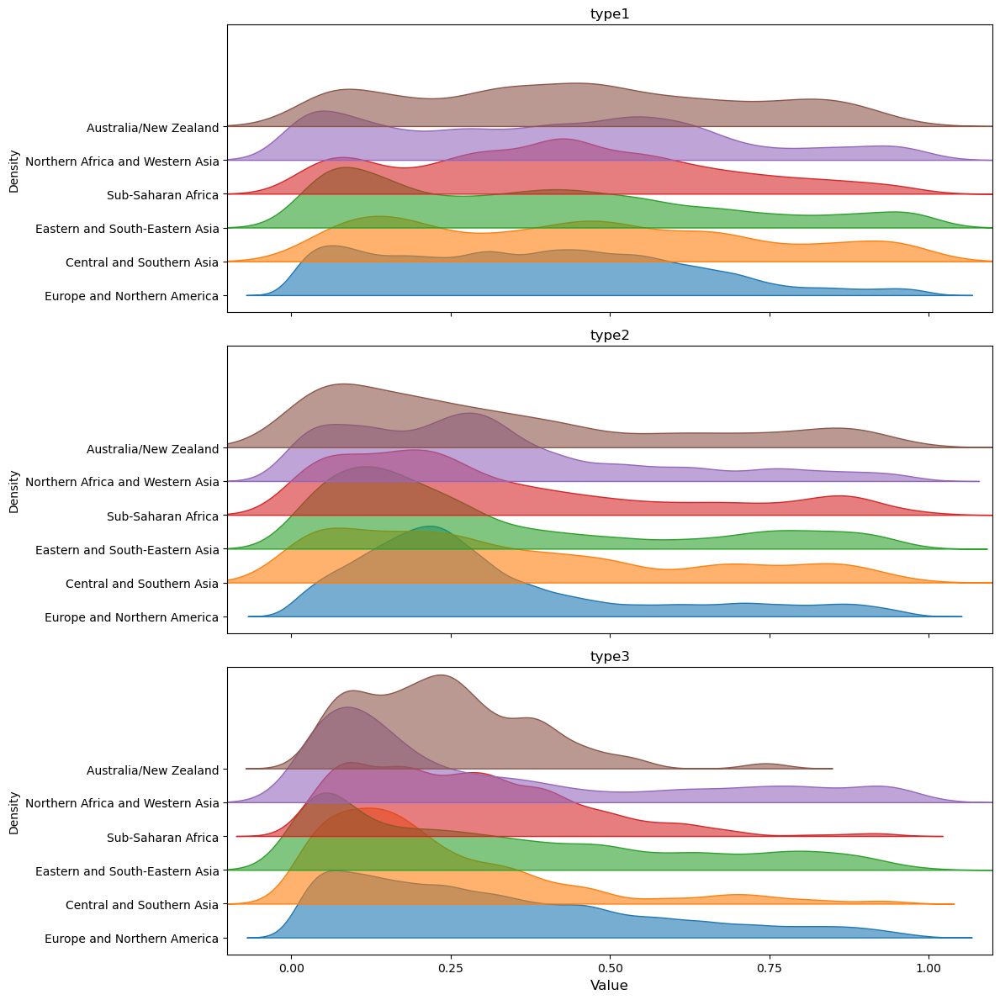

In [16]:
matplotlib.rcParams['pdf.fonttype'] = 42
# Example list of types
listt = ['type1', 'type2', 'type3']

# Filter regions with at least 30 samples
filtered_df = usageandmeta.groupby('region').filter(lambda x: len(x) >= 30)
filtered_df = filtered_df.copy()
filtered_df['region'] = filtered_df['region'].astype(str)

# Define a consistent color palette for regions
region_order = filtered_df['region'].unique()
palette = sns.color_palette("tab10", n_colors=len(region_order))
color_mapping = dict(zip(region_order, palette))  # Map each region to a specific color

# Set up the subplot grid
fig, axes = plt.subplots(len(listt), 1, figsize=(12, len(region_order) * 2), sharex=True)

# Loop through each type and create a subplot
vertical_spacing = 1.1  # Spacing between regions
for ax, type_name in zip(axes, listt):
    melted_df = filtered_df[['region', type_name]].rename(columns={type_name: 'Value'})
    melted_df['region'] = pd.Categorical(melted_df['region'], categories=region_order, ordered=True)
    
    for i, region in enumerate(region_order):
        subset = melted_df[melted_df['region'] == region]
        sns.kdeplot(
            data=subset,
            x='Value',
            fill=True,
            bw_adjust=0.6,
            alpha=0.6,
            linewidth=1,
            color=color_mapping[region],  
            ax=ax,
        )
        
        # Shift the KDE vertically for spacing
        for poly in ax.collections[-1].get_paths():  
            poly.vertices[:, 1] += i * vertical_spacing  # Adjust vertical position
    
    # Adjust y-axis limits for extra white space
    ax.set_ylim(-vertical_spacing * 0.5, len(region_order) * vertical_spacing + vertical_spacing * 2)
    ax.set_yticks([i * vertical_spacing for i in range(len(region_order))])
    ax.set_yticklabels(region_order, fontsize=10)
    ax.set_title(f"{type_name}", fontsize=12)
    ax.set_xlim(-0.1, 1.1) 
    ax.set_xticks([0, 0.25, 0.5, 0.75, 1])  

plt.xlabel("Value", fontsize=12)
plt.tight_layout()
plt.savefig(f'{figure_path}/S7C_kde_region_plot.pdf')
plt.show()


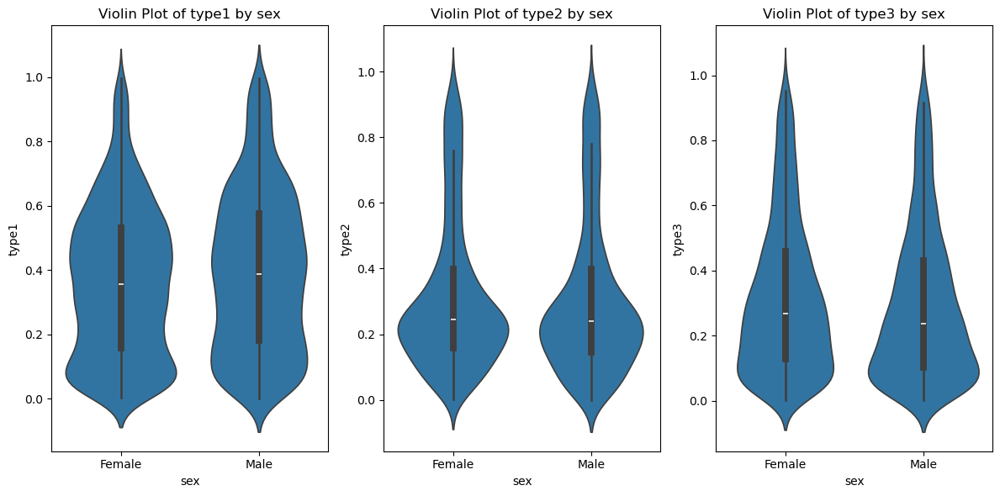

=== KS Test: type1 by sex ===
KS Statistic: 0.0667
p-value:      0.0000

=== KS Test: type2 by sex ===
KS Statistic: 0.0344
p-value:      0.0582

=== KS Test: type3 by sex ===
KS Statistic: 0.0645
p-value:      0.0000



In [25]:
df = usageandmeta.dropna(subset=['sex', 'type1', 'type2', 'type3'])

# Create a figure with subplots side by side
fig, axes = plt.subplots(1, 3, figsize=(12, 6), sharey=False)

# 1. Violin plot for type1 by sex
sns.violinplot(data=df, x='sex', y='type1', ax=axes[0])
axes[0].set_title('Violin Plot of type1 by sex')
axes[0].set_xlabel('sex')
axes[0].set_ylabel('type1')
# 2. Violin plot for type2 by sex
sns.violinplot(data=df, x='sex', y='type2', ax=axes[1])
axes[1].set_title('Violin Plot of type2 by sex')
axes[1].set_xlabel('sex')
axes[1].set_ylabel('type2')
# 3. Violin plot for type3 by sex
sns.violinplot(data=df, x='sex', y='type3', ax=axes[2])
axes[2].set_title('Violin Plot of type3 by sex')
axes[2].set_xlabel('sex')
axes[2].set_ylabel('type3')

plt.tight_layout()
plt.savefig(f'{figure_path}/S7A_sex_vs_archetypes_violin.pdf')
plt.show()


# List of columns to test
types = ['type1', 'type2', 'type3']

for t in types:
    # Separate Male and Female data for each type
    male_data = df.loc[df['sex'] == 'Male', t]
    female_data = df.loc[df['sex'] == 'Female', t]
    
    # Kolmogorov-Smirnov 2-sample test
    ks_stat, p_val = ks_2samp(male_data, female_data)
    
    print(f"=== KS Test: {t} by sex ===")
    print(f"KS Statistic: {ks_stat:.4f}")
    print(f"p-value:      {p_val:.4f}\n")



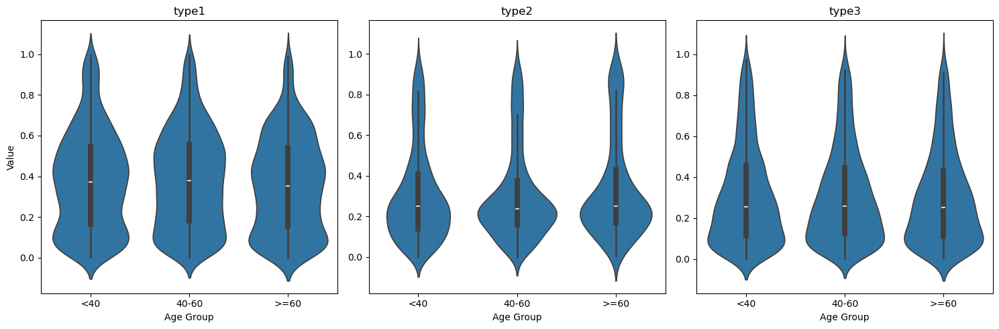



=== Analysis for type1 ===

ANOVA results:
F-statistic: 3.9853
p-value:     0.0186

Pairwise KS Tests:
<40 vs 40-60: KS stat = 0.0282, p = 0.2775
<40 vs >=60: KS stat = 0.0337, p = 0.3352
40-60 vs >=60: KS stat = 0.0483, p = 0.0409


=== Analysis for type2 ===

ANOVA results:
F-statistic: 8.3041
p-value:     0.0003

Pairwise KS Tests:
<40 vs 40-60: KS stat = 0.0468, p = 0.0089
<40 vs >=60: KS stat = 0.0736, p = 0.0004
40-60 vs >=60: KS stat = 0.0554, p = 0.0120


=== Analysis for type3 ===

ANOVA results:
F-statistic: 0.6890
p-value:     0.5021

Pairwise KS Tests:
<40 vs 40-60: KS stat = 0.0277, p = 0.2975
<40 vs >=60: KS stat = 0.0265, p = 0.6395
40-60 vs >=60: KS stat = 0.0318, p = 0.3625


In [24]:
# Create a figure with three subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=False)  # Wider figure for 3 plots

matplotlib.rcParams['pdf.fonttype'] = 42
plt.rcParams['pdf.fonttype'] = 42

# Create age groups
usageandmeta['age_group'] = pd.cut(usageandmeta['age'],
                                  bins=[0, 40, 60, 200],
                                  labels=['<40', '40-60', '>=60'],
                                  right=False)

# Drop rows with missing values
usageandmeta.dropna(subset=['age', 'type1', 'type2', 'type3'], inplace=True)

# List of columns to test
types = ['type1', 'type2', 'type3']

# 1. Violin plots
# Plot each type in its own subplot
for i, (t, ax) in enumerate(zip(types, axes)):
    sns.violinplot(x='age_group', y=t, data=usageandmeta, ax=ax)
    ax.set_title(t)  # Use column name as title
    ax.set_xlabel('Age Group')
    ax.set_ylabel('Value' if i == 0 else '')  # Only show y-label on leftmost plot

# Adjust layout and save
plt.tight_layout()
plt.savefig(f'{figure_path}/S7A_agegroup_vs_archetypes_violin.pdf', bbox_inches='tight', dpi=300)
plt.show()

# 2. ANOVA and KS tests
for t in types:
    print(f"\n\n=== Analysis for {t} ===")
    
    # Get data for each age group
    groups = {
        '<40': usageandmeta[usageandmeta['age_group'] == '<40'][t],
        '40-60': usageandmeta[usageandmeta['age_group'] == '40-60'][t],
        '>=60': usageandmeta[usageandmeta['age_group'] == '>=60'][t]
    }
    
    # ANOVA
    f_stat, p_anova = f_oneway(*groups.values())
    print(f"\nANOVA results:")
    print(f"F-statistic: {f_stat:.4f}")
    print(f"p-value:     {p_anova:.4f}")
    
    # Pairwise KS tests
    print("\nPairwise KS Tests:")
    for (g1, g2) in combinations(groups.keys(), 2):
        ks_stat, p_ks = ks_2samp(groups[g1], groups[g2])
        print(f"{g1} vs {g2}: KS stat = {ks_stat:.4f}, p = {p_ks:.4f}")

